# Facial recognition system
#### Budapest University of Technology and Economics
#### Artificial Intelligence in Data Science
#### Student: Rebeca Sarai Gonzalez Guerra


In this present notebook, I create a facial recognition system from scratch with a Convolutional Neural Network(CNN) structure using Keras, to recognize me and my sister. A lot of people we have met(Neighbours and friends) say that we look very much alike and they even confuse us sometimes. 

Later on, in this project and Notebook, I build another model using the Transfer Learning technique, to reach higher validation accuracy scores and when testing with new and different photos, as well as when using the web camera with different lighting.

All along, for both of the models, applying Data Augmentation as well. With this technique, I was able to augment data up to 2794 photos, by randomly adding or removing brightness, saturation, and more angles of the faces by flipping them and rotating them. It’s because of this Data Augmentation that I could create a more robust model.

The model is tested in different types of photos taken from different cameras/phones, different times, and different looks/make-up. With a confusion matrix, it’s possible to see how the models can have more precision when predicting one of the classes (in this case either for my sister’s face or mine)

**At the end of the project I was able to make the model recognize me even when using a face mask!! Very interesting for me.**





In [ ]:
!pip install mtcnn
import numpy as np
%pylab inline
import matplotlib.pyplot as plt
from scipy import signal
import os
import io
from keras.models import Sequential
from keras.layers import Dense, Conv2D, MaxPooling2D, Dropout, Flatten
from keras import models
from keras.utils.np_utils import to_categorical
import skimage.draw
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from keras.applications import vgg16
from keras.applications.vgg16 import preprocess_input
from os import listdir
from PIL import Image
from numpy import asarray
from matplotlib import pyplot
from mtcnn.mtcnn import MTCNN
from os.path import isdir
from numpy import savez_compressed
from numpy import asarray

     |████████████████████████████████| 2.3MB 17.5MB/s 
Populating the interactive namespace from numpy and matplotlib


In [ ]:
import keras
keras.__version__

'2.4.3'


# Detect faces with Scikit-image

In [ ]:
import matplotlib.pyplot as plt
from matplotlib import patches

def show_detected_face(result, detected, title="Face image"):
    plt.figure(figsize=(12, 10))
    plt.imshow(result)
    img_desc = plt.gca()
    plt.set_cmap('gray')
    plt.title(title)
    plt.axis('off')
    if len(detected) > 0:
      for patch in detected:
          
          img_desc.add_patch(
              patches.Rectangle(
                  (patch['c'], patch['r']),
                  patch['width'],
                  patch['height'],
                  fill=False,
                  color='r',
                  linewidth=2)
          )
    plt.show()

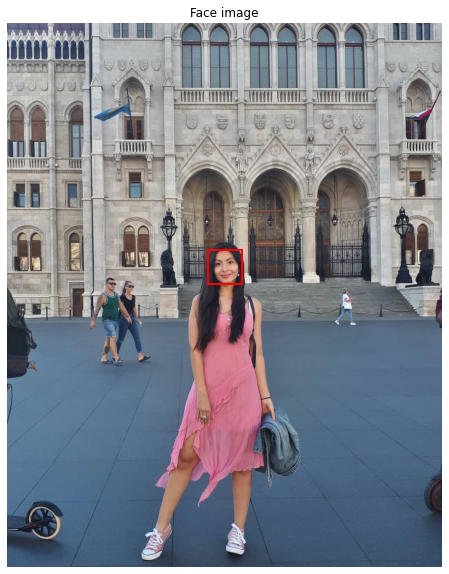

In [ ]:
from skimage import data, io
from skimage.feature import Cascade


# Load the trained file from the module root.
trained_file = data.lbp_frontal_face_cascade_filename()

# Initialize the detector cascade.
detector = Cascade(trained_file)

face_image = io.imread('me.jpg')

detected = detector.detect_multi_scale(img=face_image,
                                       scale_factor=1.2,
                                       step_ratio=1,
                                       min_size=(80, 80),
                                       max_size=(1000, 1000))

show_detected_face(face_image, detected)

[{'r': 563, 'c': 499, 'width': 84, 'height': 84}]


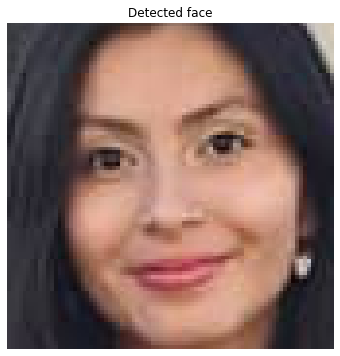

In [ ]:
def crop_face(result, detected, title="Detected face"):
  if len(detected) >0:
      rostro= result[detected[0]['r']:detected[0]['r']+detected[0]['width'], detected[0]['c']:detected[0]['c']+detected[0]['height']]
      plt.figure(figsize=(8, 6))
      plt.imshow(rostro)    
      plt.title(title)
      plt.axis('off')
      plt.show()

print(detected)
crop_face(face_image, detected)


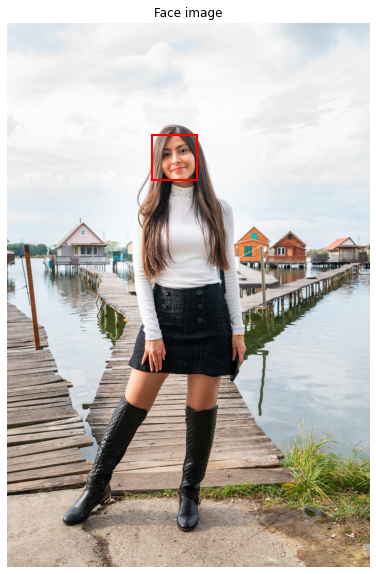

[{'r': 395, 'c': 512, 'width': 158, 'height': 158}]


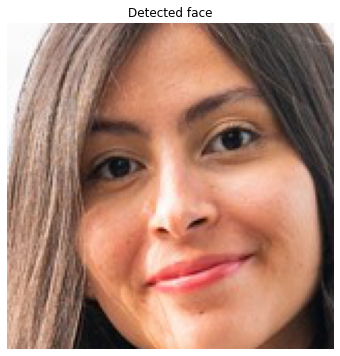

In [ ]:
face_image = io.imread('me-in-tata.jpg')

detected = detector.detect_multi_scale(img=face_image,
                                       scale_factor=1.2,
                                       step_ratio=1,
                                       min_size=(100, 100),
                                       max_size=(1000, 1000))

show_detected_face(face_image, detected)
print(detected)
crop_face(face_image, detected)

#### Althought only works for front images. Not for other angles.
That's why I will try and use another face detection technique, later on.

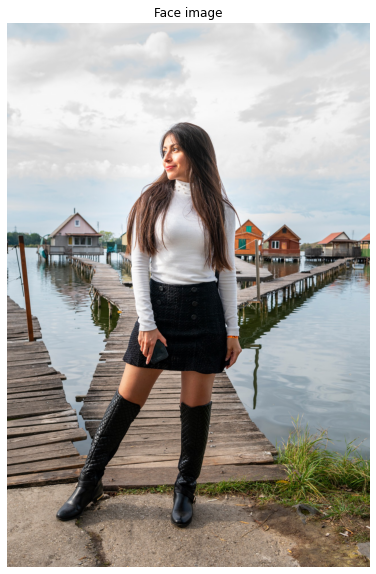

[]


In [ ]:
face_image = io.imread('me-in-tata-2.jpg')

detected = detector.detect_multi_scale(img=face_image,
                                       scale_factor=1.5,
                                       step_ratio=1,
                                       min_size=(100, 100),
                                       max_size=(800, 800))


show_detected_face(face_image, detected)
print(detected)
crop_face(face_image, detected)

# Detect faces with a Keras

Since Scikit-image face detection technique is really good for front images, we also want the model to recognize faces in profile and other angles from the photos. 

For that, I tried and compared MTCNN. A Keras implementation for face detection.

In [ ]:
!pip install mtcnn

1 (160, 160, 3)
2 (160, 160, 3)
3 (160, 160, 3)
4 (160, 160, 3)
5 (160, 160, 3)
Out of index
6 (160, 160, 3)


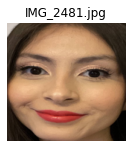

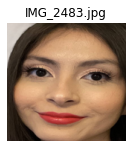

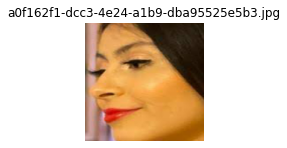

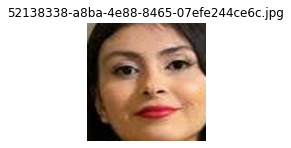

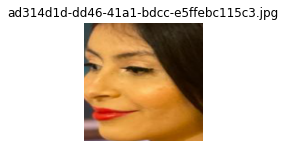

<Figure size 864x720 with 0 Axes>

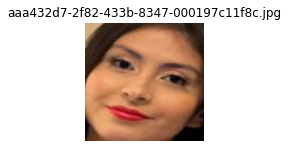

In [ ]:

# extract a single face from a given photograph
def extract_face(filename, required_size=(160, 160)):
  # load image from file
  image = Image.open(filename)
  # convert to RGB, if needed
  image = image.convert('RGB')
  # convert to array
  pixels = asarray(image)
  # create the detector, using default weights
  detector = MTCNN()
  # detect faces in the image
  results = detector.detect_faces(pixels)
  # extract the bounding box from the first face
  try:
    x1, y1, width, height = results[0]['box']
    # bug fix
    x1, y1 = abs(x1), abs(y1)
    x2, y2 = x1 + width, y1 + height
    # extract the face
    face = pixels[y1:y2, x1:x2]
    # resize pixels to the model size
    image = Image.fromarray(face)
    image = image.resize(required_size)
    face_array = asarray(image)
    return face_array
  except IndexError:
    face_array=[]
    print("Out of index")

# specify folder to plot
i = 1
folder = '/content/dataset/ex/'
# enumerate files
for filename in listdir(folder):
  # path
  path = folder + filename
  # get face
  face = extract_face(path)
  from matplotlib.pyplot import figure
  figure(num=None, figsize=(12, 10))
  if face is not None:
    print(i, face.shape)
    # plot
    pyplot.subplot(4, 2, i)
    pyplot.title(filename)
    pyplot.axis('off')
    pyplot.imshow(face)
    i += 1
pyplot.show()

In [ ]:
from os import listdir
from os.path import isdir
from PIL import Image
from matplotlib import pyplot
from numpy import savez_compressed
from numpy import asarray
from mtcnn.mtcnn import MTCNN


# extract a single face from a given photograph
def extract_face(filename, required_size=(224, 224)):
  # load image from file
  image = Image.open(filename)
  # convert to RGB, if needed
  image = image.convert('RGB')
  # convert to array
  pixels = asarray(image)
  # create the detector, using default weights
  detector = MTCNN()
  # detect faces in the image
  results = detector.detect_faces(pixels)
  # extract the bounding box from the first face
  try:
    x1, y1, width, height = results[0]['box']
    # bug fix
    x1, y1 = abs(x1), abs(y1)
    x2, y2 = x1 + width, y1 + height
    # extract the face
    face = pixels[y1:y2, x1:x2]
    # resize pixels to the model size
    image = Image.fromarray(face)
    image = image.resize(required_size)
    face_array = asarray(image)
    return face_array
  except IndexError:
    face_array=[]
    print("Out of index")
  
 
# load images and extract faces for all images in a directory
def load_faces(directory):
  faces = list()
  # enumerate files
  for filename in listdir(directory):
    # path
    path = directory + filename
    # get face
    face = extract_face(path)
    if face is not None:
      # store
      faces.append(face)
  return faces
 
# load a dataset that contains one subdir for each class that in turn contains images
def load_dataset(directory):
	X, y = list(), list()
	# enumerate folders, on per class
	for subdir in listdir(directory):
		# path
		path = directory + subdir + '/'
		# skip any files that might be in the dir
		if not isdir(path):
			continue
		# load all faces in the subdirectory
		faces = load_faces(path)
		# create labels
		labels = [subdir for _ in range(len(faces))]
		# summarize progress
		print('>loaded %d examples for class: %s' % (len(faces), subdir))
		# store
		X.extend(faces)
		y.extend(labels)
	return asarray(X), asarray(y)

In [ ]:
# extract all faces from a given photograph
def extract_all_faces(filename, required_size=(224, 224)):
  # load image from file
  original_image = Image.open(filename)
  # convert to RGB, if needed
  image = original_image.convert('RGB')
  # convert to array
  pixels = asarray(image)
  # create the detector, using default weights
  detector = MTCNN()
  # detect faces in the image
  results = detector.detect_faces(pixels)
  # extract the bounding box from the faces
  face_array=[]
  try:
    for result in results:
      x1, y1, width, height = result['box']
      x1, y1 = abs(x1), abs(y1)
      x2, y2 = x1 + width, y1 + height
      # extract the face
      face = pixels[y1:y2, x1:x2]
      #print()
      #print(original_image)
      #print(face.shape[0])
      #print("original_image.size[0]/20")
      #print(original_image.size[0]/20)
      if face.shape[0] >= original_image.size[0]/20:
        print(face.shape)
        # resize pixels to the model size
        image = Image.fromarray(face)
        image = image.resize(required_size)
        face_array.append(asarray(image))

    return face_array
  except IndexError:
    print("Out of index")
  


# Detect faces from my photos and creating dataset

#### Create face dataset from folders
To generate dataset of faces from folder files, uncomment the next line. 

For portability, I compress the generated face datasets into "npz" files that can be unzipped later anytime in the code. That way I can load the project fast enough anywhere in colab or other jupyter notebooks as long as I have those npz files.

In [ ]:
# Generate face training dataset from file folders

#trainX, trainy = load_dataset('/content/image_dataset/')
#print(trainX.shape, trainy.shape)
# load test dataset
# save arrays to one file in compressed format
#savez_compressed('rebeca_photos_1.npz', trainX, trainy)


Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
>loaded 166 examples for class: Rebeca
>loaded 0 examples for class: .ipynb_checkpoints
(166, 224, 224, 3) (166,)


In [ ]:
trainX.shape

(166, 224, 224, 3)

In [ ]:
trainy[0]

'Rebeca'

# Join dataset and turn it to NumPy arrays

In [ ]:
# load the faces dataset from npz files
data = load('cam_dataset_rebeca_and_daniela.npz')     
x_train_cam, y_train_cam = data['arr_0'], data['arr_1']
print('Loaded: ', x_train_cam.shape, y_train_cam.shape)

Loaded:  (1285, 224, 224, 3) (1285,)


In [ ]:
# load the faces dataset
data = load('rebeca_photos_1.npz')     
x_train_rebeca, y_train_rebeca = data['arr_0'], data['arr_1']
print('Loaded: ', x_train_rebeca.shape, y_train_rebeca.shape)

Loaded:  (166, 224, 224, 3) (166,)


In [ ]:
np.unique(y_train_cam, return_counts=True)

(array(['Daniela', 'Rebeca'], dtype='<U7'), array([744, 541]))

In [ ]:
x_train = np.concatenate((x_train_cam, x_train_rebeca), axis=0)
x_train.shape

(1451, 224, 224, 3)

In [ ]:
y_train = np.concatenate((y_train_cam, y_train_rebeca), axis=0)
y_train.shape

(1451,)

In [ ]:
np.unique(y_train, return_counts=True)

(array(['Daniela', 'Rebeca'], dtype='<U7'), array([744, 707]))

**Uncomment the following cell of code only if generating Daniela's face dataset from folder files is intended**

In [ ]:
#x_daniela_photos, y_daniela_photos = load_dataset('/content/daniela/')
#print(x_daniela_photos.shape, y_daniela_photos.shape)

Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
Out of index
>loaded 105 examples for class: Daniela
>loaded 0 examples for class: .ipynb_checkpoints
(105, 224, 224, 3) (105,)


In [ ]:
#savez_compressed('daniela_photos_google.npz', x_daniela_photos, y_daniela_photos)

In [ ]:
# load the faces dataset
data = load('daniela_photos_google.npz')     
x_daniela_photos, y_daniela_photos = data['arr_0'], data['arr_1']
print('Loaded: ', x_daniela_photos.shape, y_daniela_photos.shape)

Loaded:  (105, 224, 224, 3) (105,)


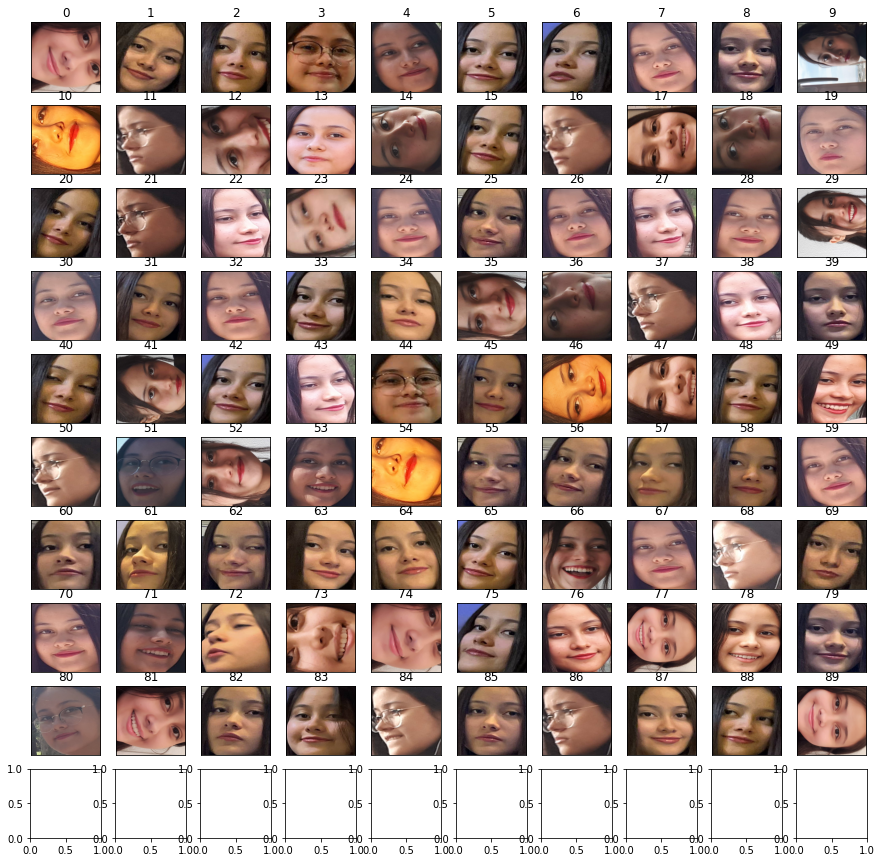

In [ ]:
plt.subplots(10,10,figsize=(15,15))
for i in range(90):
    plt.subplot(10,10,i+1)
    plt.title(i*1)
    plt.imshow(x_daniela_photos[i*1])
    plt.xticks([])
    plt.yticks([])

In [ ]:
# Some faces where actually food 
#x_daniela_photos = np.delete(x_daniela_photos, [2,15,27,37,21,44,53,55,60,65,67,70,71,98,99],axis=0)
#y_daniela_photos = np.delete(y_daniela_photos, [2,15,27,37,21,44,53,55,60,65,67,70,71,98,99],axis=0)

In [ ]:
y_daniela_photos.shape

(90,)

In [ ]:
x_d = x_train[np.where(y_train == 'Daniela')]
print(x_d.shape)

y_d = y_train[np.where(y_train == 'Daniela')]
print(y_d.shape)

(744, 224, 224, 3)
(744,)


In [ ]:
n = 600  # for 2 random indices
index = np.random.choice(x_d.shape[0], n, replace=False)  

x_daniela_sample = x_d[index]
y_daniela_sample = y_d[index]

In [ ]:
x_daniela_all = np.concatenate((x_daniela_sample,x_daniela_photos), axis=0)
y_daniela_all = np.concatenate((y_daniela_sample,y_daniela_photos), axis=0)

In [ ]:
x_daniela_all.shape

(690, 224, 224, 3)

In [ ]:
x_r = x_train[np.where(y_train == 'Rebeca')]
print(x_r.shape)

y_r = y_train[np.where(y_train == 'Rebeca')]
print(y_r.shape)

(707, 224, 224, 3)
(707,)


In [ ]:
X = np.concatenate((x_daniela_all,x_r),axis=0)
Y = np.concatenate((y_daniela_all,y_r),axis=0)

In [ ]:
X.shape

(1397, 224, 224, 3)

In [ ]:
Y.shape

(1397,)

In [ ]:
np.unique(Y, return_counts=True)

(array(['Daniela', 'Rebeca'], dtype='<U7'), array([690, 707]))

In [ ]:
# The latest full dataset
savez_compressed('complete_dataset_rebeca_and_daniela.npz', X, Y)

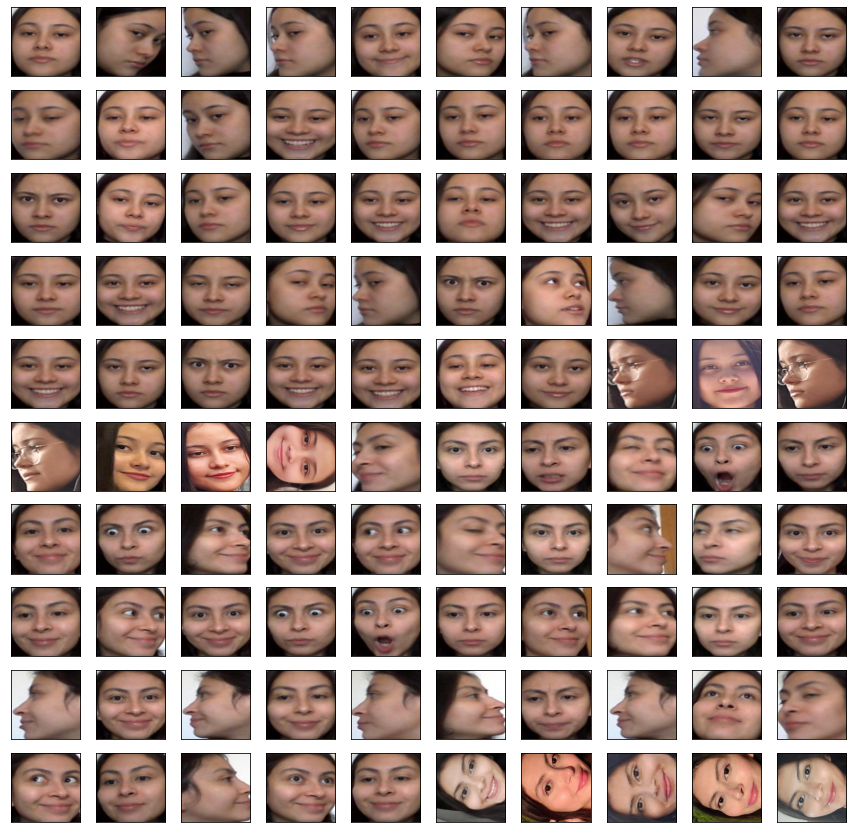

In [ ]:
plt.subplots(10,10,figsize=(15,15))
for i in range(100):
    plt.subplot(10,10,i+1)
    plt.imshow(X[i*13])
    plt.xticks([])
    plt.yticks([])

# Data augmentation


In [ ]:
# load the faces dataset
data = load('complete_dataset_rebeca_and_daniela.npz')     
X, Y = data['arr_0'], data['arr_1']
print('Loaded: ', X.shape, Y.shape)

Loaded:  (1397, 224, 224, 3) (1397,)


In [ ]:
img = X[100]

In [ ]:
import cv2
import random
import numpy as np

def brightness(img, low, high):
    value = random.uniform(low, high)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    hsv = np.array(hsv, dtype = np.float64)
    hsv[:,:,1] = hsv[:,:,1]*value
    hsv[:,:,1][hsv[:,:,1]>255]  = 255
    hsv[:,:,2] = hsv[:,:,2]*value 
    hsv[:,:,2][hsv[:,:,2]>255]  = 255
    hsv = np.array(hsv, dtype = np.uint8)
    img = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
    return img

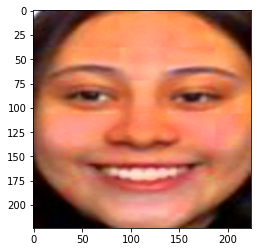

In [ ]:
img_result = brightness(img, 0.1, 2)
plt.imshow(img_result)

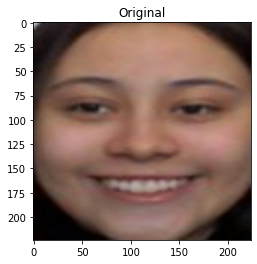

In [ ]:
plt.title("Original")
plt.imshow(img)

In [ ]:
import cv2
import random

def augment_data(imgs, scales, rotations, brightness_values, shifts, labels):
  timg=[]
  y_hat=[]
  for (img,label) in zip(imgs,labels):
    rows, cols, ch = img.shape 
    for j in rotations:
      f = random.uniform(0, 1)
      #f = random.choice([0,1])
      rot_mat = cv2.getRotationMatrix2D( (14,14), j, 1);
      affined_img = cv2.warpAffine( img, rot_mat, (cols, rows), borderValue=(1,1,1))
      resulting_img = affined_img
      if f == 1:
        resulting_img = cv2.flip(resulting_img, f)
      resulting_img = brightness(resulting_img, brightness_values[0], brightness_values[1])
      timg.append(resulting_img)
      y_hat.append(label)
  return np.array(timg), np.array(y_hat)

In [ ]:
scales = np.arange(0.9, 1, 0.1)
rotations = np.arange(0, 2)
brightness_values = [ 0.4, 2]
shifts = [ 0.2]
au_x, au_y = augment_data(X, scales, rotations, brightness_values, shifts, Y)

In [ ]:
au_x.shape

(2794, 224, 224, 3)

In [ ]:
np.unique(au_y, return_counts=True)

(array(['Daniela', 'Rebeca'], dtype='<U7'), array([1380, 1414]))

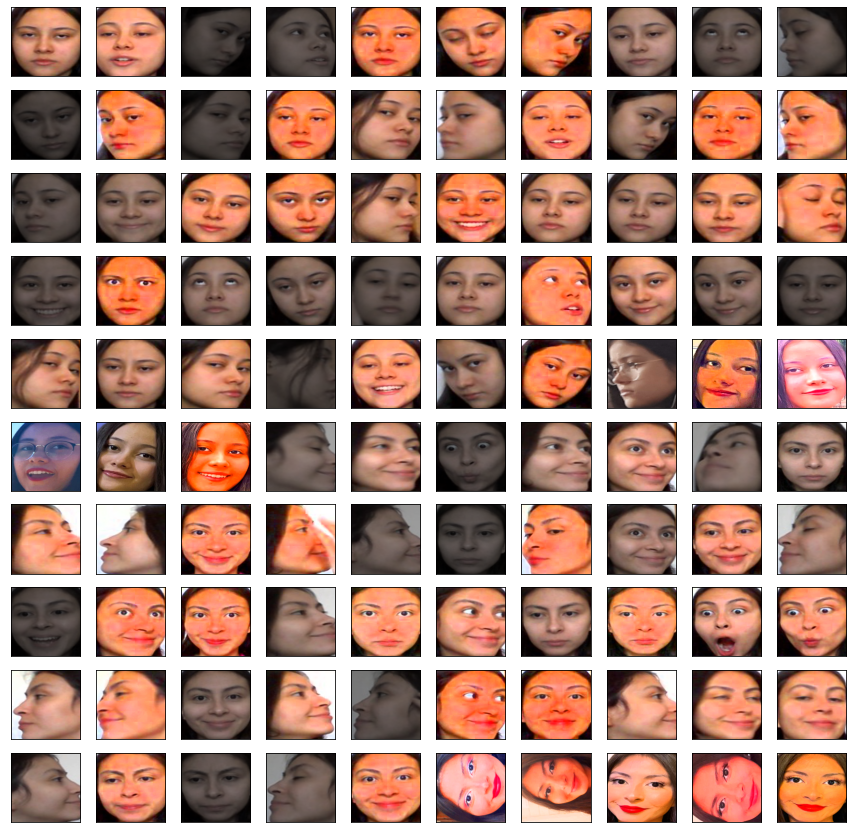

In [ ]:
plt.subplots(10,10,figsize=(15,15))
for i in range(100):
    plt.subplot(10,10,i+1)
    plt.imshow(au_x[i*26])
    plt.xticks([])
    plt.yticks([])

# Preparing dataset: One-hot encoding


In [ ]:
from sklearn.model_selection import train_test_split
# split into train test sets
au_x_train, au_x_test, au_y_train, au_y_test = train_test_split(au_x, au_y, test_size=0.33)
print(au_x_train.shape, au_x_test.shape, au_y_train.shape, au_y_test.shape)

(1871, 224, 224, 3) (923, 224, 224, 3) (1871,) (923,)


In [ ]:
from sklearn.preprocessing import LabelEncoder
# label encode targets
out_encoder = LabelEncoder()
out_encoder.fit(au_y_train)
au_y_train = out_encoder.transform(au_y_train)
au_y_test = out_encoder.transform(au_y_test)

In [ ]:
au_y_train.shape

(1871,)

In [ ]:
au_y_test.shape

(923,)

In [ ]:
from keras.utils import to_categorical
au_train_labels = to_categorical(au_y_train)
au_test_labels = to_categorical(au_y_test)

print(au_train_labels.shape)
print(au_test_labels.shape)

(1871, 2)
(923, 2)


In [ ]:
# The data one-hot encoded 
savez_compressed('data_one_hot_encoded.npz', au_x_train, au_train_labels, au_x_test, au_test_labels)

In [ ]:
# load the faces dataset
data = load('data_one_hot_encoded.npz')     
au_x_train, au_train_labels, au_x_test, au_test_labels= data['arr_0'], data['arr_1'],data['arr_2'], data['arr_3']
print('Loaded: ', au_x_train.shape, au_train_labels.shape,  au_x_test.shape, au_test_labels.shape)

Loaded:  (1871, 224, 224, 3) (1871, 2) (923, 224, 224, 3) (923, 2)


# Model from scratch, using Data Augmentation
Using the augmented data, now preprocessed to meet the input requirements of the model; I use callback from Keras to get more efficient training. 

With EarlyStopping, I avoid overfitting, it will stop the training when there is no improvement. I defined what to monitor while saving the model checkpoints. I will monitor validation loss for stopping the model training.

With ModelCheckPoint, I'm saving the best model from the training as "facial_recognition_daniela_rebeca_scratch.h5" to, later on, compare it.


In [ ]:
from keras.layers import BatchNormalization, GlobalMaxPooling2D

model1 = Sequential()

# Convolution layers
model1.add(Conv2D(32, (3,3), input_shape = (224, 224, 3), activation = 'relu', padding='same'))
model1.add(MaxPooling2D(pool_size=(2, 2)))

model1.add(Conv2D(64, (2, 2), activation='relu', padding='same'))
model1.add(MaxPooling2D(2))

model1.add(Conv2D(64, (2, 2), activation='relu', padding='same'))
model1.add(MaxPooling2D(pool_size=(2, 2)))

model1.add(Flatten())
model1.add(Dense(units = 64, activation = 'relu'))
model1.add(Dropout(0.2)) 

# Output
model1.add(Dense(units = 2, activation = 'softmax'))
model1.summary()


Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 224, 224, 32)      896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 112, 112, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 112, 112, 64)      8256      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 56, 56, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 56, 56, 64)        16448     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 28, 28, 64)        0         
_________________________________________________________________
flatten (Flatten)            (None, 50176)             0

In [ ]:
# Compiling the CNN
model1.compile(optimizer = 'adam',
                   loss='categorical_crossentropy',
                   metrics = ['accuracy'])

In [ ]:
from keras.callbacks import EarlyStopping, ModelCheckpoint

early_stop = EarlyStopping(monitor='val_loss', patience = 3)
checkpoint = ModelCheckpoint('facial_recognition_daniela_rebeca_scratch.h5', monitor = 'val_acc')

In [ ]:
pre_au_x_train = preprocess_input(au_x_train)
pre_au_x_test = preprocess_input(au_x_test)

In [ ]:
history = model1.fit(pre_au_x_train, au_train_labels, 
                     batch_size = 128, epochs=20, 
                     validation_data = (pre_au_x_test, au_test_labels), 
                     callbacks = [early_stop, checkpoint])

Epoch 1/20
15/15 [==============================] - 12s 252ms/step - loss: 23.5781 - accuracy: 0.5283 - val_loss: 0.6762 - val_accuracy: 0.5666
Epoch 2/20
15/15 [==============================] - 2s 167ms/step - loss: 0.6739 - accuracy: 0.5732 - val_loss: 0.4725 - val_accuracy: 0.8137
Epoch 3/20
15/15 [==============================] - 3s 174ms/step - loss: 0.4372 - accuracy: 0.7895 - val_loss: 0.3070 - val_accuracy: 0.8765
Epoch 4/20
15/15 [==============================] - 3s 172ms/step - loss: 0.2436 - accuracy: 0.9003 - val_loss: 0.2102 - val_accuracy: 0.9404
Epoch 5/20
15/15 [==============================] - 2s 167ms/step - loss: 0.1575 - accuracy: 0.9392 - val_loss: 0.1165 - val_accuracy: 0.9632
Epoch 6/20
15/15 [==============================] - 3s 174ms/step - loss: 0.1115 - accuracy: 0.9610 - val_loss: 0.1967 - val_accuracy: 0.9285
Epoch 7/20
15/15 [==============================] - 3s 173ms/step - loss: 0.0995 - accuracy: 0.9545 - val_loss: 0.0996 - val_accuracy: 0.9718
Epoc

In [ ]:
preds1 = model1.predict(pre_au_x_test, batch_size=50) # y_test are the truth, real labels correct ones.
# classes are the model predictions (That can be wrong or match the real ones)
print("Total predicted classes are:",len(preds1))

Total predicted classes are: 923


### We accomplish 97% of accuracy!

In [ ]:
from sklearn.metrics import accuracy_score
accuracy_score(au_test_labels.argmax(axis=1), preds1.argmax(axis=1))

0.980498374864572

### Model architecture

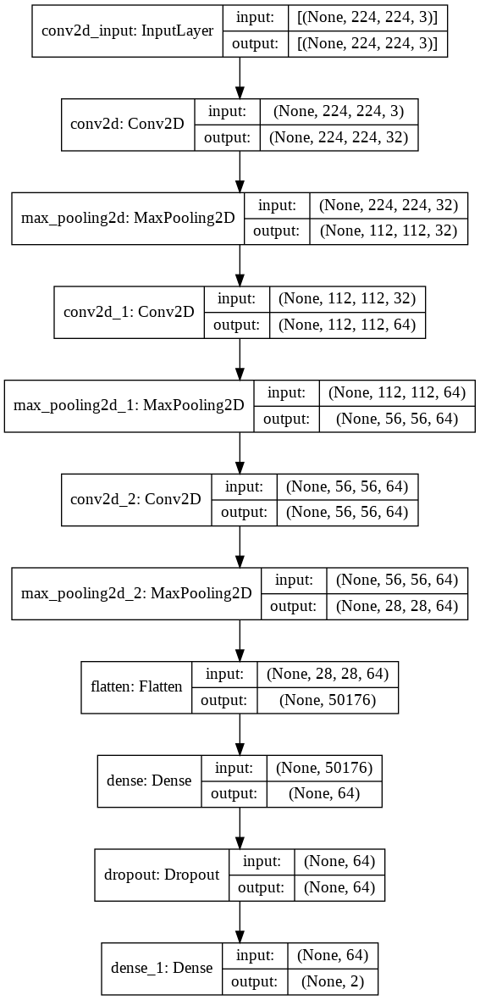

In [ ]:
from keras.utils.vis_utils import plot_model
plot_model(model1, to_file='model_plot1.png', show_shapes=True, show_layer_names=True)

### Confusion matrix
Generate a confusion matrix to see the confidence of the predictions and where the model confused. Here we can see that it's better at recognizing me than my sister(Daniela).

Edit: In another time, I  re-created, trained, and ran the model once again, and see that the result this time was now perfectly balanced with 97% of precision for both of us. So here we can see proof of the small random factor when training the models.

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
y_pred1 = np.argmax(preds1, axis=1)
print('Confusion Matrix')
print(confusion_matrix(au_test_labels.argmax(axis=1), y_pred1))
print('Classification Report')
target_names = ['Daniela', 'Rebeca']
print(classification_report(au_test_labels.argmax(axis=1), y_pred1, target_names=target_names))

Confusion Matrix
[[439  11]
 [ 17 456]]
Classification Report
              precision    recall  f1-score   support

     Daniela       0.96      0.98      0.97       450
      Rebeca       0.98      0.96      0.97       473

    accuracy                           0.97       923
   macro avg       0.97      0.97      0.97       923
weighted avg       0.97      0.97      0.97       923



In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
y_pred1 = np.argmax(preds1, axis=1)
print('Confusion Matrix')
print(confusion_matrix(au_test_labels.argmax(axis=1), y_pred1))
print('Classification Report')
target_names = ['Daniela', 'Rebeca']
print(classification_report(au_test_labels.argmax(axis=1), y_pred1, target_names=target_names))

Confusion Matrix
[[438  12]
 [ 14 459]]
Classification Report
              precision    recall  f1-score   support

     Daniela       0.97      0.97      0.97       450
      Rebeca       0.97      0.97      0.97       473

    accuracy                           0.97       923
   macro avg       0.97      0.97      0.97       923
weighted avg       0.97      0.97      0.97       923



## Testing it on new photos
I will test the model with different new photos. Using functions to detect the face, extract it, pass it to the model and, with a boolean as a parameter, see the prediction confidence for both classes.

In [ ]:
# load and evaluate a saved model
from numpy import loadtxt
from keras.models import load_model

# load model
model1 = load_model('facial_recognition_daniela_rebeca_scratch.h5')

In [ ]:
def test_model1_on_photo_from_path(file_path,verbose=False):
  recognized_person = {0:'Daniela',1:'Rebeca'}
  plt.figure(figsize=(10, 8))
  image = Image.open(file_path)
  plt.title("Original photo")
  plt.imshow(image)
  plt.show()
  image = extract_face(file_path)
  preprocessed_image = preprocess_input(image)
  shaped_img = preprocessed_image.reshape(1,224,224,3)
  classes = model1.predict(shaped_img) # y_test are the truth, real labels correct ones.
  # classes are the model predictions (That can be wrong or match the real ones)
  print("Total predicted classes are:",len(classes))
  print(int(classes.argmax(axis=1)))
  plt.title(recognized_person[int(classes.argmax(axis=1))])
  plt.imshow(image)
  plt.show()
  if verbose:
    print(classes)

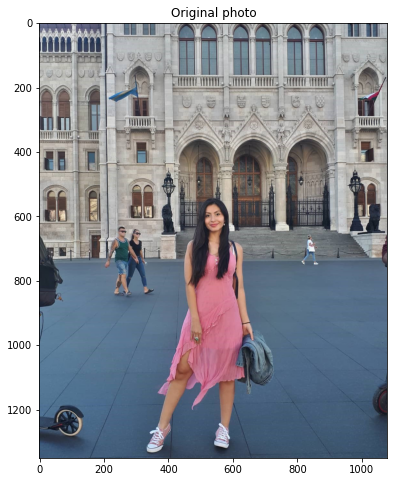

Total predicted classes are: 1
1


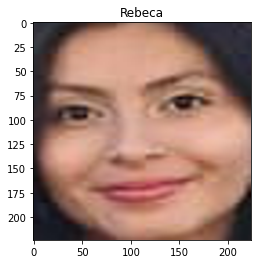

In [ ]:
test_model1_on_photo_from_path("/content/me.jpg")

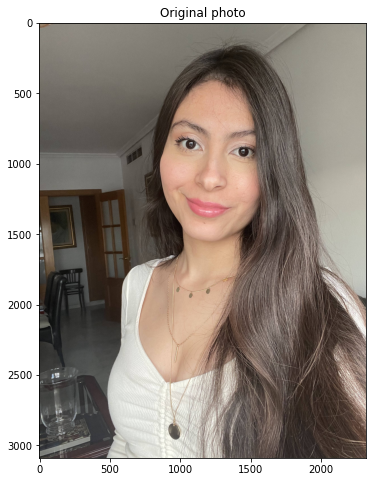

Total predicted classes are: 1
1


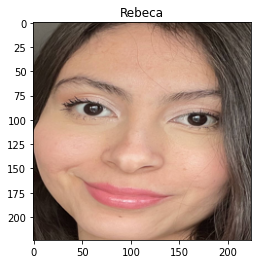

[[0.02085746 0.97914255]]


In [ ]:
test_model1_on_photo_from_path("/content/IMG_1575.jpg", True)

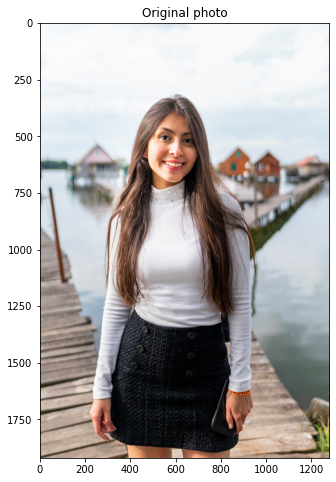

Total predicted classes are: 1
0


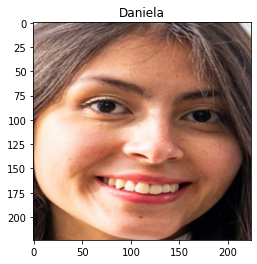

[[0.5703464  0.42965358]]


In [ ]:
test_model1_on_photo_from_path("/content/me-in-tata-3.jpg", True)

That photo above was actually me (Rebeca) in Bokodi! Although the difference of confidence between the two classses is little:  By only 14%

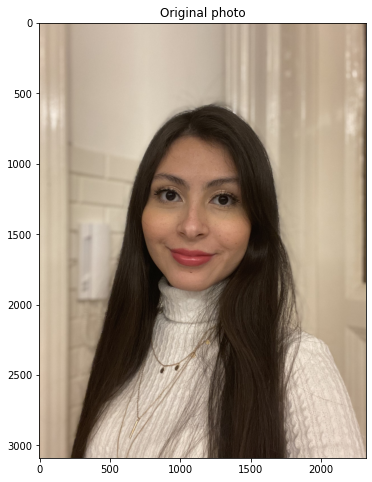

Total predicted classes are: 1
1


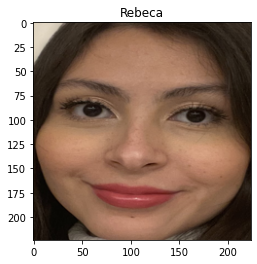

[[0.07100073 0.9289993 ]]


In [ ]:
test_model1_on_photo_from_path("IMG_0308.jpg", True)



### Let's try with more photos of Daniela

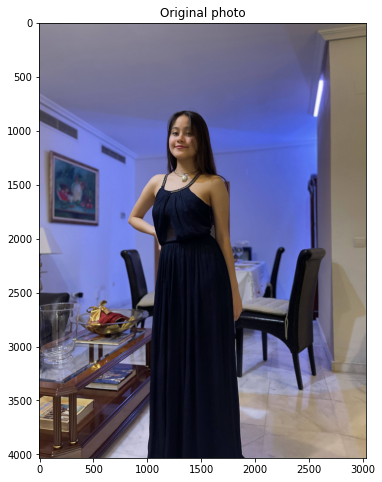

Total predicted classes are: 1
0


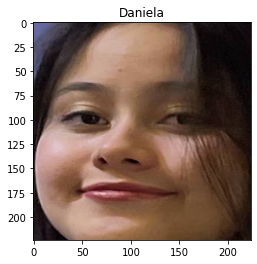

[[0.93885726 0.06114273]]


In [ ]:
test_model1_on_photo_from_path("/content/IMG_2340.jpg",True)

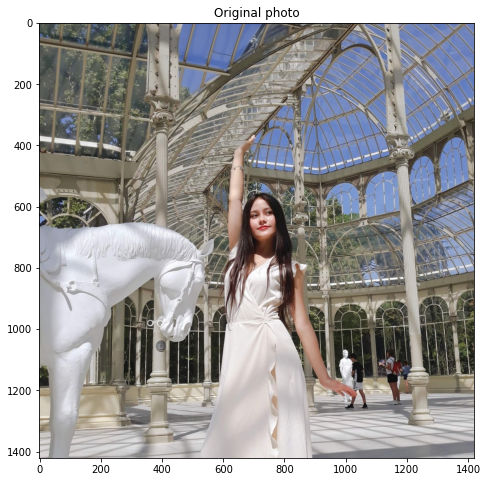

Total predicted classes are: 1
0


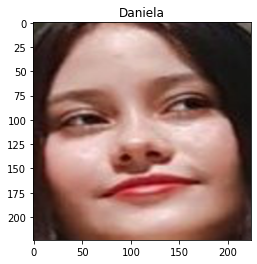

[[0.72533727 0.27466276]]


In [ ]:
test_model1_on_photo_from_path("/content/Daniela_Madrid.jpg",True)

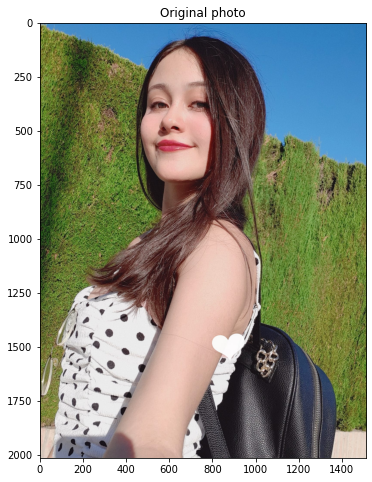

Total predicted classes are: 1
1


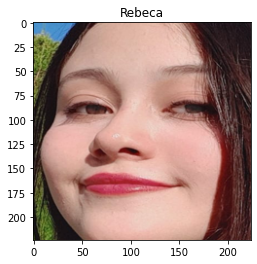

[[0.39245236 0.60754764]]


In [ ]:
test_model1_on_photo_from_path("/content/Daniela_.jpg",True)

## Connecting webcamera and testing

In [ ]:
recognized_person = {0:'Daniela',1:'Rebeca'}
def test_model_on_photo_from_path(file_path,verbose=False):
  recognized_person = {0:'Daniela',1:'Rebeca'}
  plt.figure(figsize=(10, 8))
  image = Image.open(file_path)
  plt.title("Original photo")
  plt.imshow(image)
  plt.show()
  image = extract_face(file_path)
  preprocessed_image = preprocess_input(image)
  shaped_img = preprocessed_image.reshape(1,224,224,3)
  classes = model1.predict(shaped_img) # y_test are the truth, real labels correct ones.
  # classes are the model predictions (That can be wrong or match the real ones)
  print("Total predicted classes are:",len(classes))
  print(int(classes.argmax(axis=1)))
  plt.title(recognized_person[int(classes.argmax(axis=1))])
  plt.imshow(image)
  plt.show()
  if verbose:
    print(classes)

def test_model_on_photo_all_faces_from_path(file_path,verbose=False):
  recognized_person = {0:'Daniela',1:'Rebeca'}
  plt.figure(figsize=(10, 8))
  original_image = Image.open(file_path)
  plt.title("Original photo")
  plt.imshow(original_image)
  plt.show()
  images = extract_all_faces(file_path)
  for image in images:
    preprocessed_image = preprocess_input(image)
    shaped_img = preprocessed_image.reshape(1,224,224,3)
    classes = model1.predict(shaped_img) # y_test are the truth, real labels correct ones.
    # classes are the model predictions (That can be wrong or match the real ones)
    print("Total predicted classes are:",len(classes))
    print(int(classes.argmax(axis=1)))
    plt.title(recognized_person[int(classes.argmax(axis=1))])
    plt.imshow(image)
    plt.show()
    if verbose:
      print(classes)

That last one was Daniela, not me. This time the difference is by 20%

<IPython.core.display.Javascript object>

Saved to photo.jpg


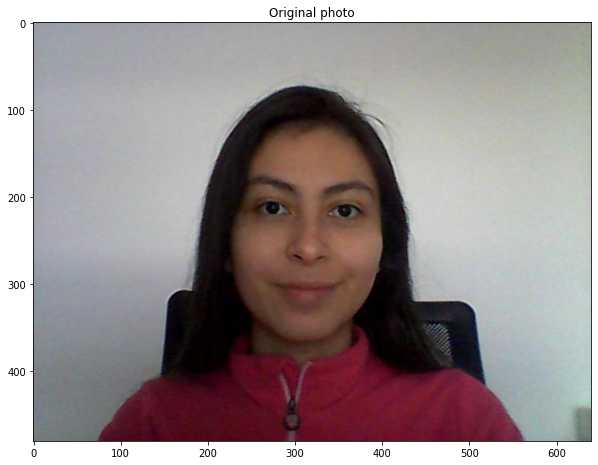

Total predicted classes are: 1
1


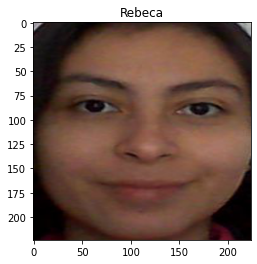

[[4.130758e-04 9.995869e-01]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

<IPython.core.display.Javascript object>

Saved to photo.jpg


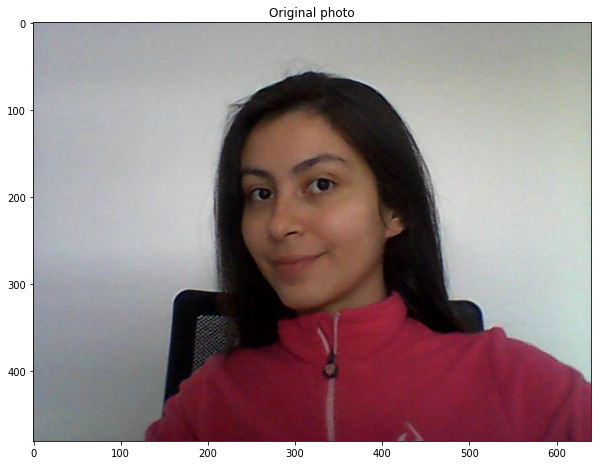

Total predicted classes are: 1
1


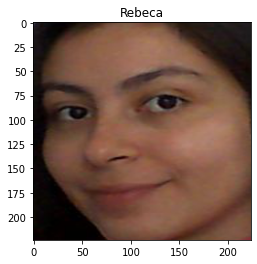

[[4.5862884e-04 9.9954140e-01]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

<IPython.core.display.Javascript object>

Saved to photo.jpg


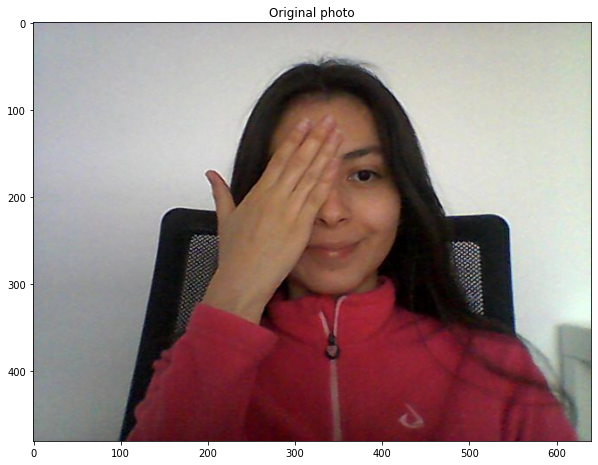

Total predicted classes are: 1
1


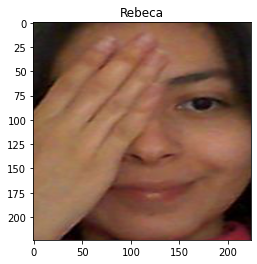

[[0.26841363 0.7315864 ]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))
  

<IPython.core.display.Javascript object>

Saved to photo.jpg


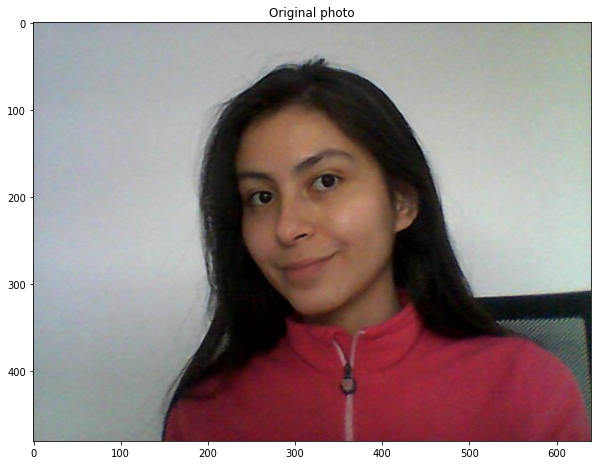

Total predicted classes are: 1
1


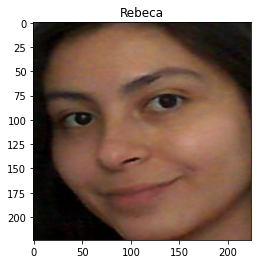

[[0.06225973 0.93774027]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))
  

<IPython.core.display.Javascript object>

Saved to photo.jpg


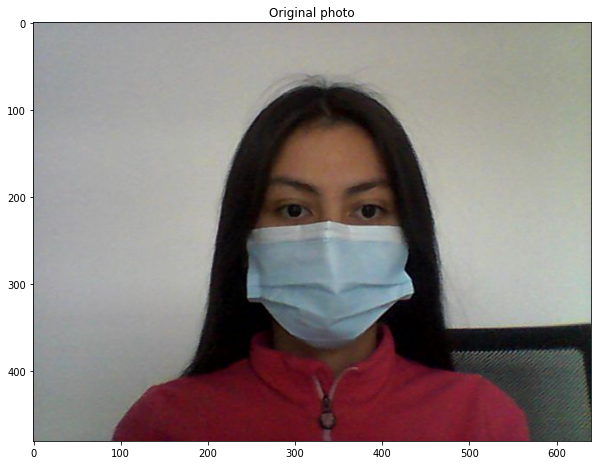

Total predicted classes are: 1
1


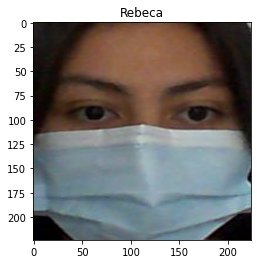

[[0.16043974 0.8395602 ]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))
  

<IPython.core.display.Javascript object>

Saved to photo.jpg


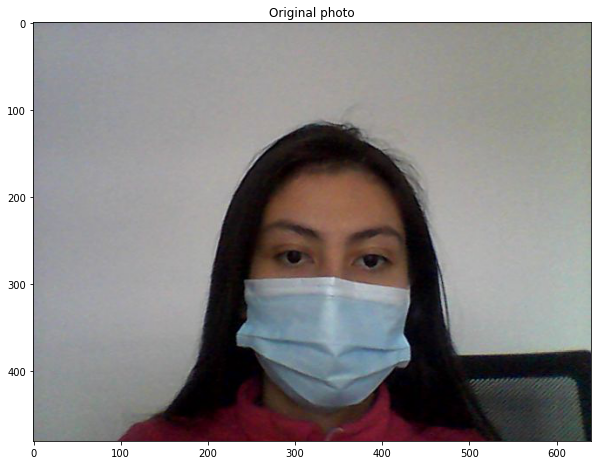

Total predicted classes are: 1
1


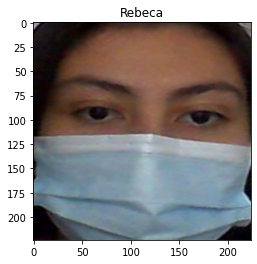

[[0.02154029 0.9784597 ]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))
  

<IPython.core.display.Javascript object>

Saved to photo.jpg


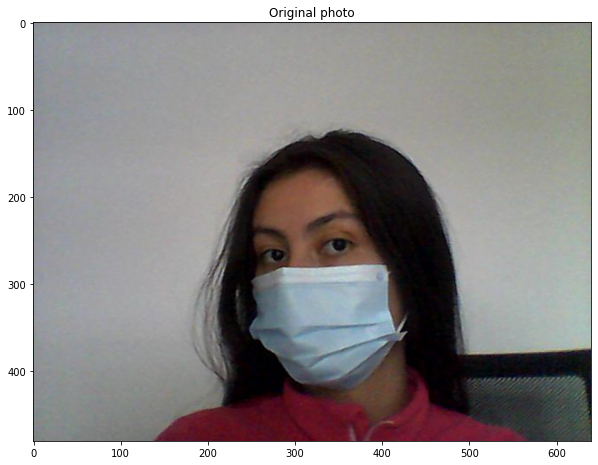

Total predicted classes are: 1
1


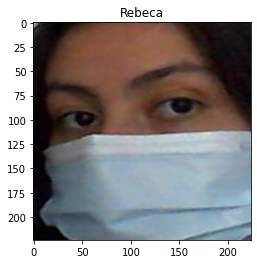

[[0.02391249 0.97608745]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))
  

<IPython.core.display.Javascript object>

Saved to photo.jpg


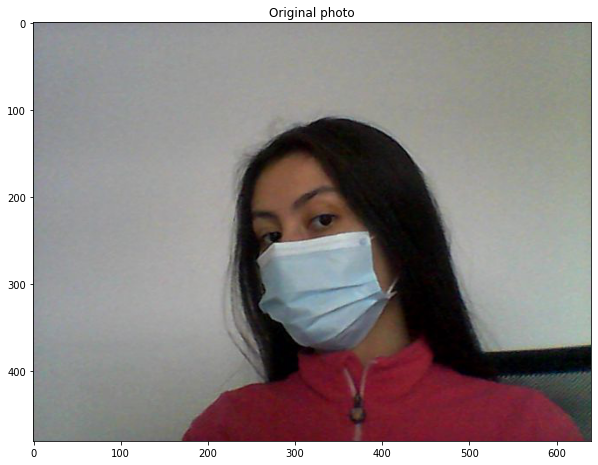

Total predicted classes are: 1
1


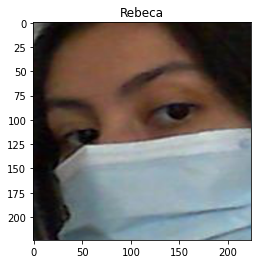

[[0.3657878 0.6342122]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))
  

<IPython.core.display.Javascript object>

Saved to photo.jpg


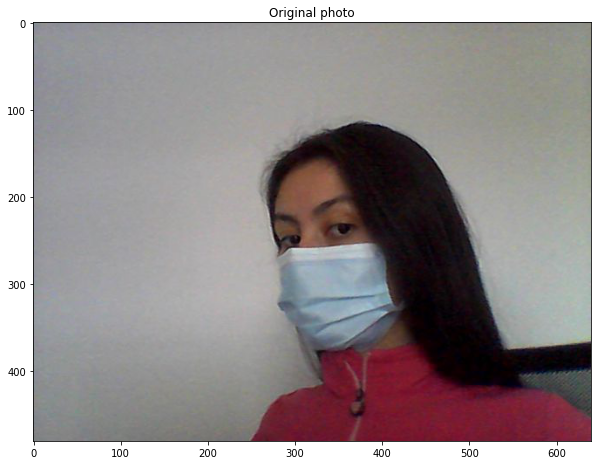

Total predicted classes are: 1
0


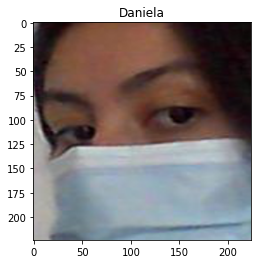

[[0.9460881 0.053912 ]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))
  

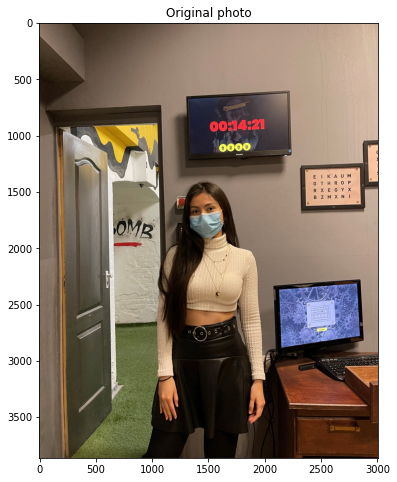

Total predicted classes are: 1
1


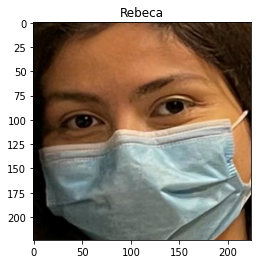

[[1.7367149e-05 9.9998260e-01]]


In [ ]:
test_model1_on_photo_from_path("/content/IMG_0087.jpg", True)

# Create model using Transfer Learning and training with augmented data

In [ ]:
from keras.layers import BatchNormalization

model_vgg16 = vgg16.VGG16(include_top=False, pooling="max", input_shape = (224, 224, 3)) 

new_layer = Dense(256, activation = 'relu')(model_vgg16.output)
new_layer = Dropout(rate = 0.5)(new_layer)

new_layer = Dense(128, activation = 'relu')(new_layer)
new_layer = Dropout(rate = 0.5)(new_layer)
new_layer = BatchNormalization()(new_layer)
new_layer = Dense(2, activation="softmax")(new_layer)

model2 = models.Model(model_vgg16.input, new_layer)

for i in range(len(model_vgg16.layers)):
  model2.layers[i].trainable = False

print(model2.summary())

Model: "model_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_8 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0   

In [ ]:
# Compiling the CNN
model2.compile(optimizer = 'adam',
                   loss='categorical_crossentropy',
                   metrics = ['accuracy'])

In [ ]:
from keras.applications.vgg16 import preprocess_input
pre_au_x_train = preprocess_input(au_x_train)
pre_au_x_test = preprocess_input(au_x_test)

In [ ]:
from keras.callbacks import EarlyStopping, ModelCheckpoint

early_stop = EarlyStopping(monitor='val_loss', patience = 3)
checkpoint = ModelCheckpoint('facial_recongition_daniela_rebeca.h5', monitor = 'val_accuracy', save_best_only=True)

In [ ]:
history = model2.fit(pre_au_x_train, au_train_labels, 
                     batch_size = 64, epochs=18, 
                     validation_data = (pre_au_x_test, au_test_labels), 
                     callbacks = [early_stop, checkpoint])

Epoch 1/18
30/30 [==============================] - 12s 381ms/step - loss: 0.8851 - accuracy: 0.5545 - val_loss: 0.4528 - val_accuracy: 0.7790
Epoch 2/18
30/30 [==============================] - 11s 373ms/step - loss: 0.6585 - accuracy: 0.6597 - val_loss: 0.2654 - val_accuracy: 0.9177
Epoch 3/18
30/30 [==============================] - 11s 380ms/step - loss: 0.4914 - accuracy: 0.7871 - val_loss: 0.2038 - val_accuracy: 0.9296
Epoch 4/18
30/30 [==============================] - 11s 378ms/step - loss: 0.3209 - accuracy: 0.8664 - val_loss: 0.1531 - val_accuracy: 0.9426
Epoch 5/18
30/30 [==============================] - 11s 371ms/step - loss: 0.2186 - accuracy: 0.9161 - val_loss: 0.1275 - val_accuracy: 0.9632
Epoch 6/18
30/30 [==============================] - 11s 367ms/step - loss: 0.1696 - accuracy: 0.9407 - val_loss: 0.0983 - val_accuracy: 0.9740
Epoch 7/18
30/30 [==============================] - 11s 366ms/step - loss: 0.1196 - accuracy: 0.9555 - val_loss: 0.0922 - val_accuracy: 0.9718

# Test it on test data

In [ ]:
preds = model2.predict(pre_au_x_test, batch_size=50) # y_test are the truth, real labels correct ones.
# classes are the model predictions (That can be wrong or match the real ones)
print("Total predicted classes are:",len(preds))

Total predicted classes are: 923


### We accomplish 98% of accuracy!

In [ ]:
from sklearn.metrics import accuracy_score
accuracy_score(au_test_labels.argmax(axis=1), preds.argmax(axis=1))

0.9826652221018418

### Model architecture

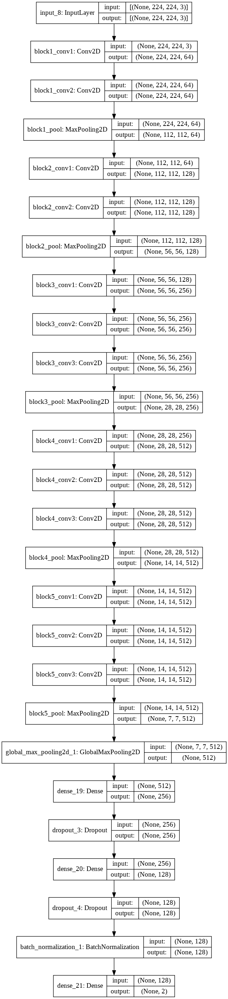

In [ ]:
from keras.utils.vis_utils import plot_model
plot_model(model2, to_file='model_plot2.png', show_shapes=True, show_layer_names=True)

### Confusion matrix
I generate a confusion matrix to see the confidence of the predictions and where the model confused. Here we can see that it's slighty better at recognizing my sister (Daniela) than me.

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
y_pred = np.argmax(preds, axis=1)
print('Confusion Matrix')
print(confusion_matrix(au_y_test, y_pred))
print('Classification Report')
target_names = ['Daniela', 'Rebeca']
print(classification_report(au_y_test, y_pred, target_names=target_names))

Confusion Matrix
[[431  15]
 [  2 475]]
Classification Report
              precision    recall  f1-score   support

     Daniela       1.00      0.97      0.98       446
      Rebeca       0.97      1.00      0.98       477

    accuracy                           0.98       923
   macro avg       0.98      0.98      0.98       923
weighted avg       0.98      0.98      0.98       923



#### Taking the best model from the training
Loading the best model (By the parameters we gave) that the Keras' callback saved in the training, we see that the best model is slighthy better than the last one, with 98.80% of accuracy

In [ ]:
from keras.models import load_model
best_model = load_model('facial_recongition_daniela_rebeca.h5')

In [ ]:
classes = best_model.predict(pre_au_x_test, batch_size=40) # y_test are the truth, real labels correct ones.
# classes are the model predictions (That can be wrong or match the real ones)
print("Total predicted classes are:",len(classes))
classes.argmax(axis=1)
accuracy_score(au_test_labels.argmax(axis=1), classes.argmax(axis=1))

Total predicted classes are: 923


0.9837486457204767

# Test it on new photos
I will test the model with different new photos. Using functions to detect the face, extract it, pass it to the model and, with a boolean as a parameter, see the prediction confidence for both classes.

In [ ]:
recognized_person = {0:'Daniela',1:'Rebeca'}
def test_model_on_photo_from_path(file_path,verbose=False):
  recognized_person = {0:'Daniela',1:'Rebeca'}
  plt.figure(figsize=(10, 8))
  image = Image.open(file_path)
  plt.title("Original photo")
  plt.imshow(image)
  plt.show()
  image = extract_face(file_path)
  preprocessed_image = preprocess_input(image)
  shaped_img = preprocessed_image.reshape(1,224,224,3)
  classes = model2.predict(shaped_img) # y_test are the truth, real labels correct ones.
  # classes are the model predictions (That can be wrong or match the real ones)
  print("Total predicted classes are:",len(classes))
  print(int(classes.argmax(axis=1)))
  plt.title(recognized_person[int(classes.argmax(axis=1))])
  plt.imshow(image)
  plt.show()
  if verbose:
    print(classes)

def test_model_on_photo_all_faces_from_path(file_path,verbose=False):
  recognized_person = {0:'Daniela',1:'Rebeca'}
  plt.figure(figsize=(10, 8))
  original_image = Image.open(file_path)
  plt.title("Original photo")
  plt.imshow(original_image)
  plt.show()
  images = extract_all_faces(file_path)
  for image in images:
    preprocessed_image = preprocess_input(image)
    shaped_img = preprocessed_image.reshape(1,224,224,3)
    classes = model2.predict(shaped_img) # y_test are the truth, real labels correct ones.
    # classes are the model predictions (That can be wrong or match the real ones)
    print("Total predicted classes are:",len(classes))
    print(int(classes.argmax(axis=1)))
    plt.title(recognized_person[int(classes.argmax(axis=1))])
    plt.imshow(image)
    plt.show()
    if verbose:
      print(classes)

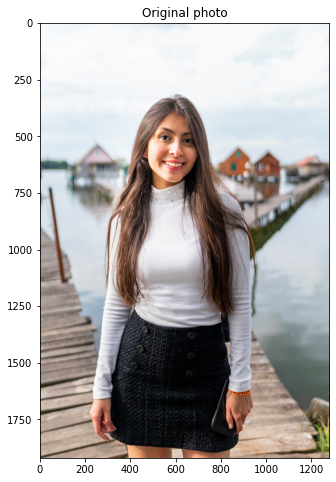

Total predicted classes are: 1
1


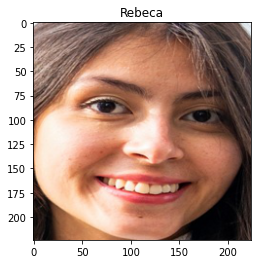

In [ ]:
test_model_on_photo_from_path("/content/me-in-tata-3.jpg")

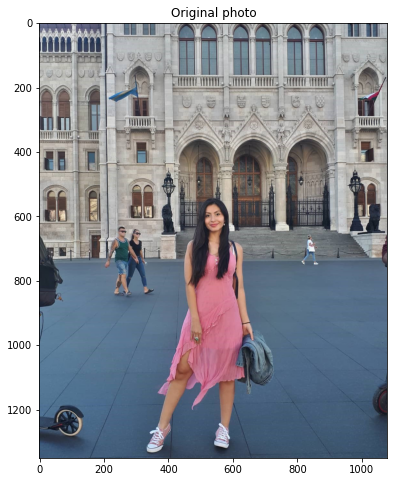

Total predicted classes are: 1
1


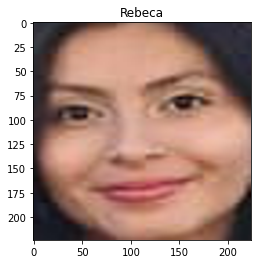

In [ ]:
test_model_on_photo_from_path("/content/me.jpg")

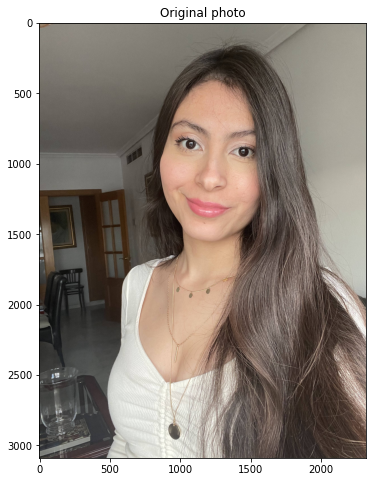

Total predicted classes are: 1
1


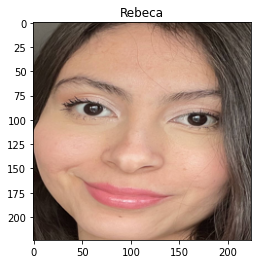

In [ ]:
test_model_on_photo_from_path("/content/IMG_1575.jpg")

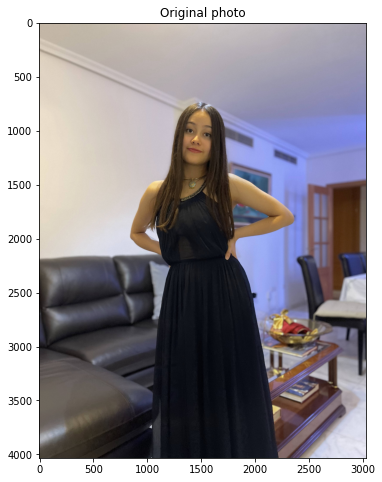

Total predicted classes are: 1
0


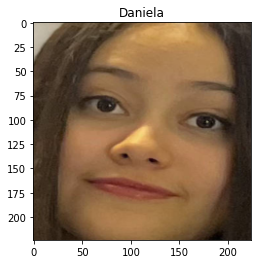

[[0.85081613 0.14918387]]


In [ ]:

test_model_on_photo_from_path("/content/IMG_2278.jpg", True)

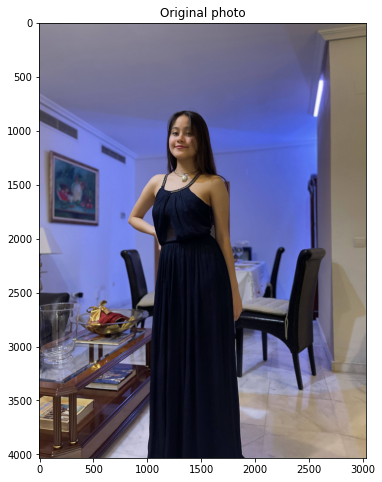

Total predicted classes are: 1
0


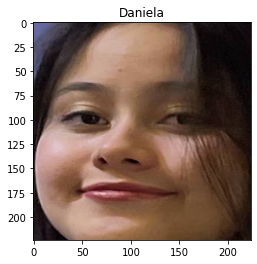

[[0.9446491  0.05535088]]


In [ ]:
test_model_on_photo_from_path("/content/IMG_2340.jpg",True)

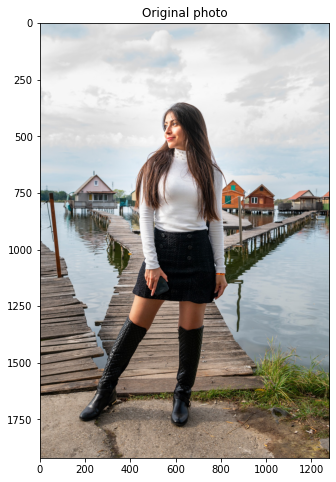

Total predicted classes are: 1
1


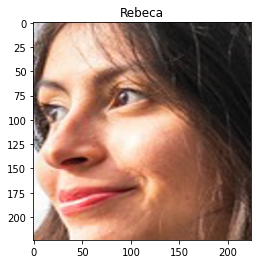

[[0.08593981 0.9140602 ]]


In [ ]:
#plt.figure(figsize=(10, 8))


test_model_on_photo_from_path("me-in-tata-2.jpg", True)

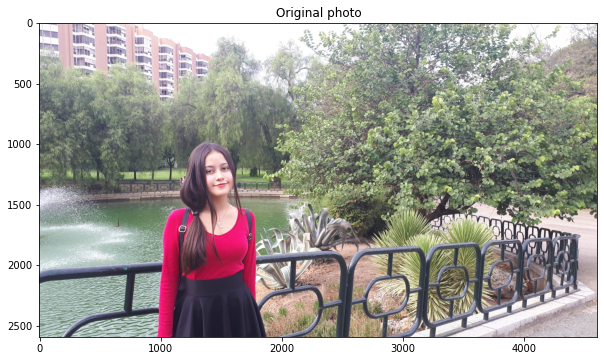

Total predicted classes are: 1
0


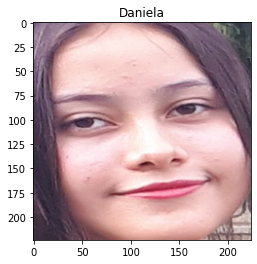

[[0.9900315  0.00996852]]


In [ ]:
test_model_on_photo_from_path("/content/20190920_181551.jpg", True)

# Testing with both of us

Trying in photos where both of us are and see the results

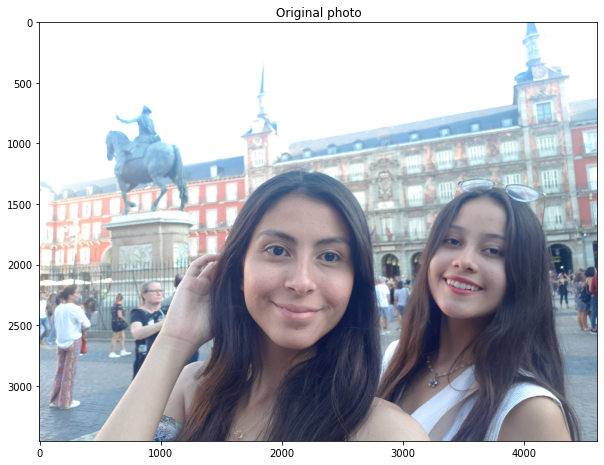

(958, 728, 3)
(1296, 951, 3)
Total predicted classes are: 1
0


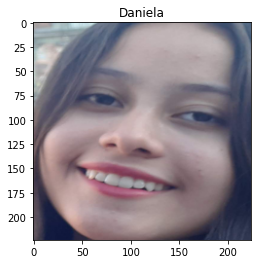

[[0.61774766 0.3822523 ]]
Total predicted classes are: 1
1


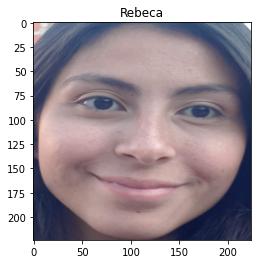

[[8.0099714e-04 9.9919897e-01]]


In [ ]:
test_model_on_photo_all_faces_from_path("20190907_193542.jpg", True)

# Connecting webcamera and testing 

In [ ]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

<IPython.core.display.Javascript object>

Saved to photo.jpg


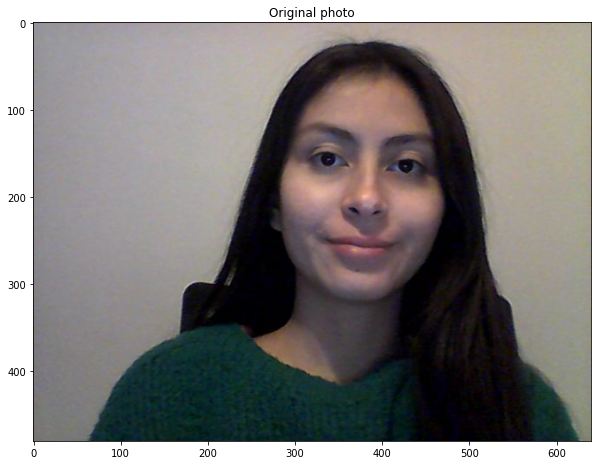

Total predicted classes are: 1
1


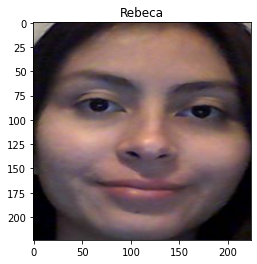

In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

<IPython.core.display.Javascript object>

Saved to photo.jpg


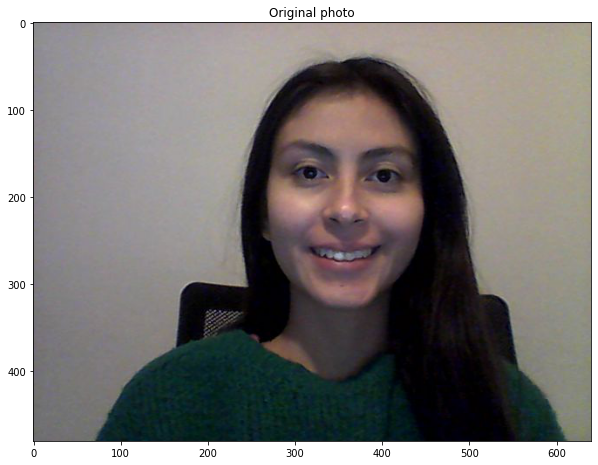

Total predicted classes are: 1
1


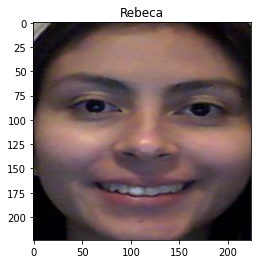

[[0.0012782 0.9987218]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

#### Testing it with my sister

In [ ]:
# load and evaluate a saved model
from numpy import loadtxt
from keras.models import load_model

# load model
model2 = load_model('facial_recongition_daniela_rebeca.h5')

<IPython.core.display.Javascript object>

Saved to photo.jpg


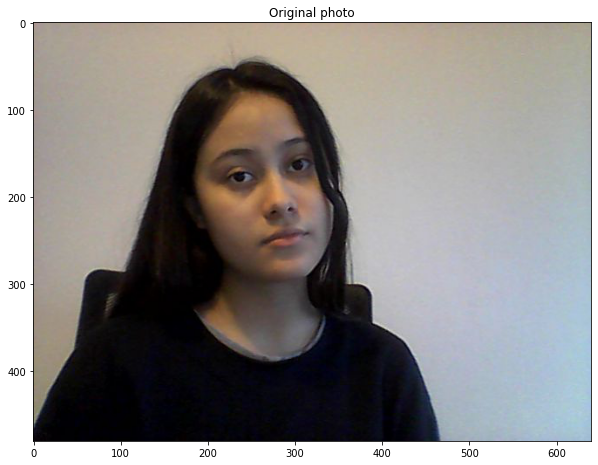

Total predicted classes are: 1
0


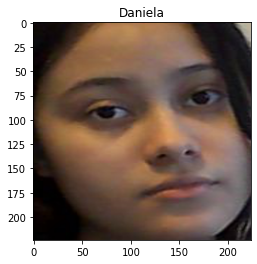

[[9.9998891e-01 1.1076865e-05]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

<IPython.core.display.Javascript object>

Saved to photo.jpg


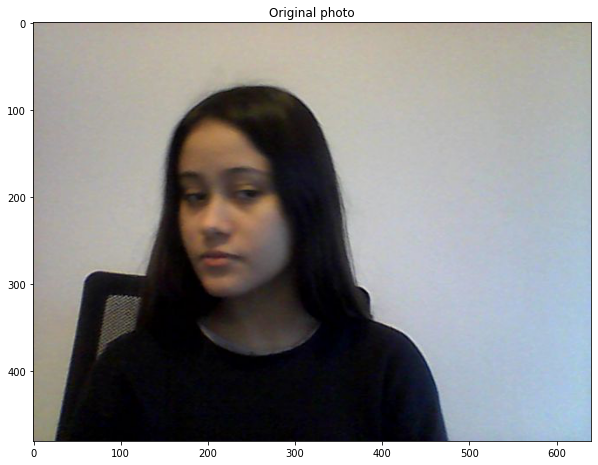

Total predicted classes are: 1
0


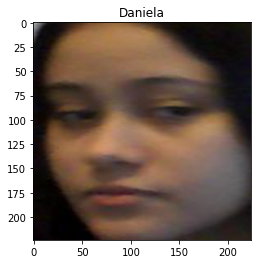

[[0.958935   0.04106497]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

<IPython.core.display.Javascript object>

Saved to photo.jpg


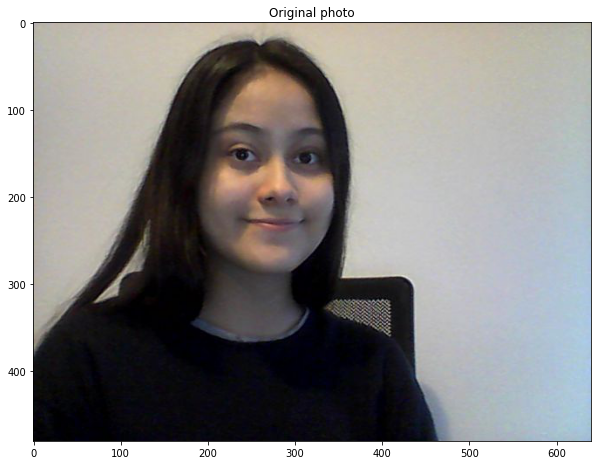

Total predicted classes are: 1
0


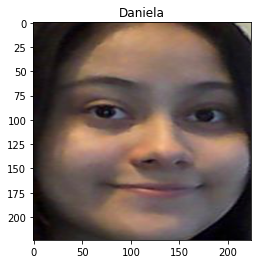

[[0.9947108  0.00528924]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

**It's 99% sure it's me, Rebeca.**

### Trying multiple facial expressions 

<IPython.core.display.Javascript object>

Saved to photo.jpg


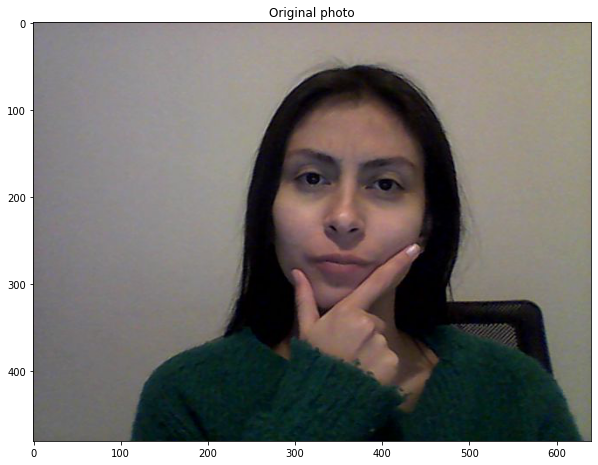

Total predicted classes are: 1
1


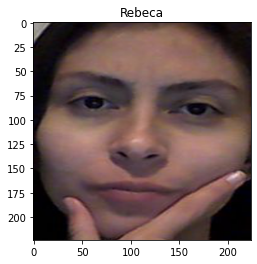

[[0.01215834 0.98784167]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

<IPython.core.display.Javascript object>

Saved to photo.jpg


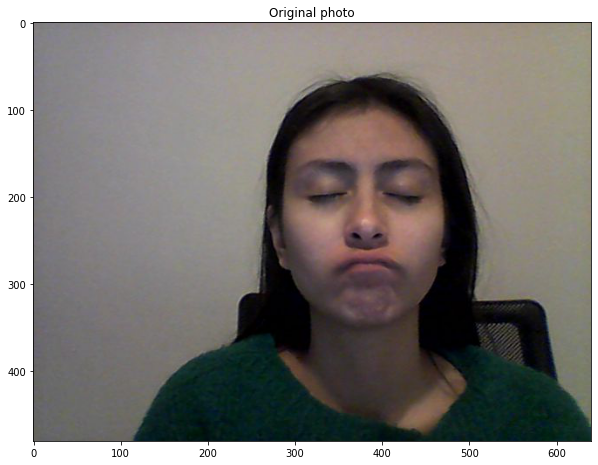

Total predicted classes are: 1
1


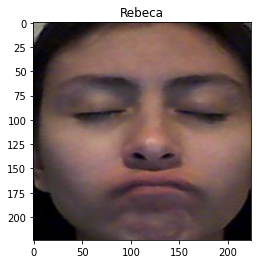

[[0.1961699  0.80383015]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

<IPython.core.display.Javascript object>

Saved to photo.jpg


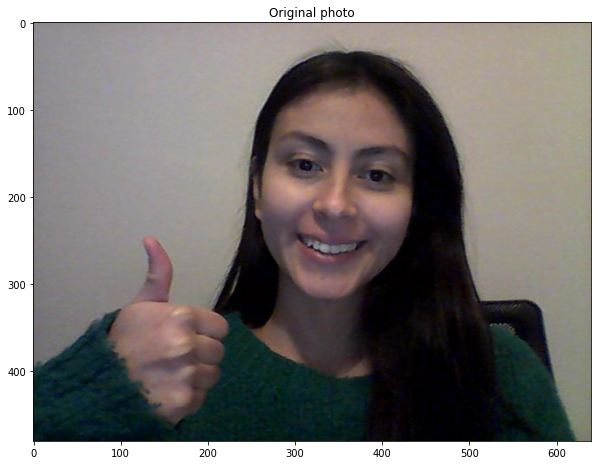

Total predicted classes are: 1
1


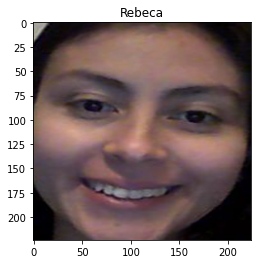

[[0.13562308 0.86437684]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

<IPython.core.display.Javascript object>

Saved to photo.jpg


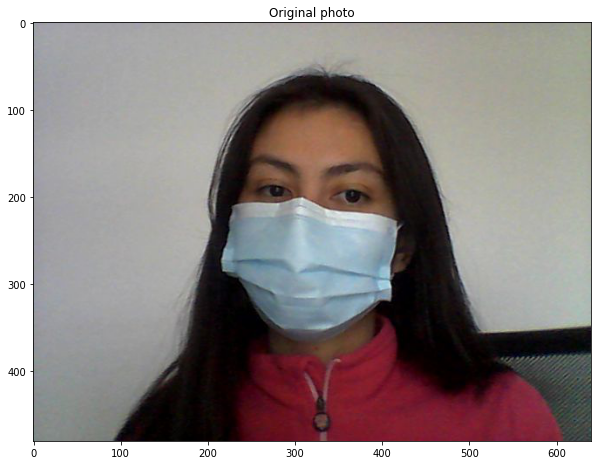

Total predicted classes are: 1
1


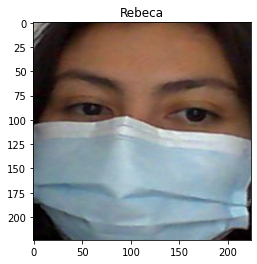

[[0.15732631 0.84267366]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

<IPython.core.display.Javascript object>

Saved to photo.jpg


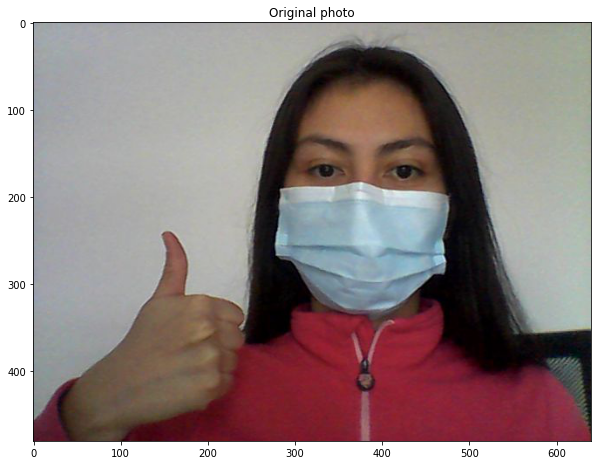

Total predicted classes are: 1
1


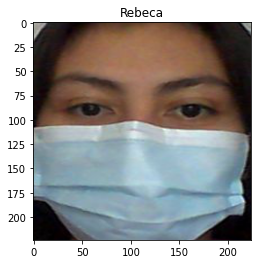

[[0.2784172  0.72158283]]


In [ ]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

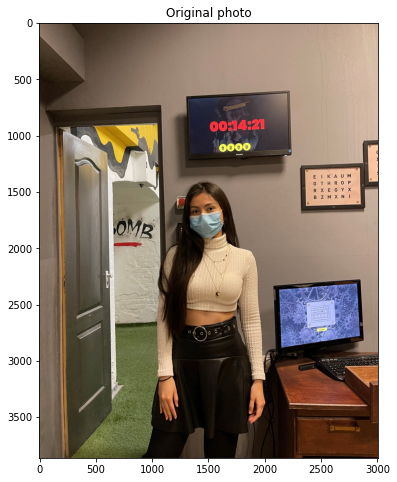

Total predicted classes are: 1
1


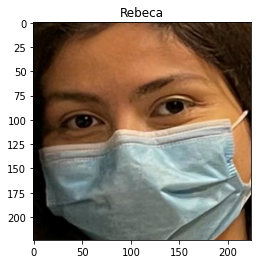

[[0.00859283 0.99140716]]


In [ ]:
test_model_on_photo_from_path("/content/IMG_0087.jpg", True)

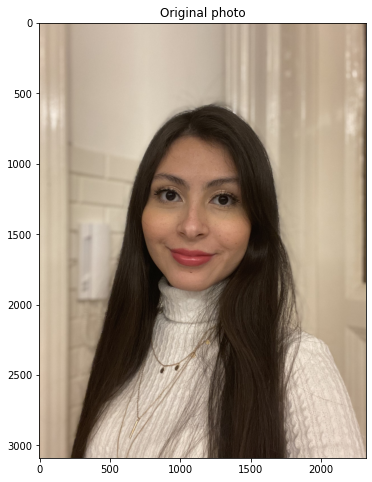

Total predicted classes are: 1
1


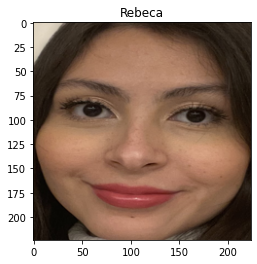

[[0.00193075 0.9980692 ]]


In [26]:
test_model_on_photo_from_path("/content/IMG_0308.jpg", True)